# Working with MRI data

You're going to need to install another package, *nilearn* to make this work.  You should be able to run `conda install nilearn` in your class environment.  On the command-line, if you're using an environment made for class, activate it first.  For example, my environment is called "scipy" and I'd first `conda activate scipy` before installing *nilearn*.

We're going to use 2 nifti images: `T1_al_seg.nii.gz`, a segmentation of a brain using SynthSeg and `T1_al_segres.nii.gz`, a structural of that brain in the same 1mm resolution as the segmentation.  

Here's a simple example of loading the image out of your local *data* folder and displaying it. We're going to use the [nilearn load_img](https://nilearn.github.io/stable/modules/generated/nilearn.image.load_img.html#nilearn.image.load_img) function as it's a lot easier to work with than the *NiBabel* it's based on.  We'll also use it's [plot_anat](https://nilearn.github.io/stable/modules/generated/nilearn.plotting.plot_anat.html#nilearn.plotting.plot_anat) function.

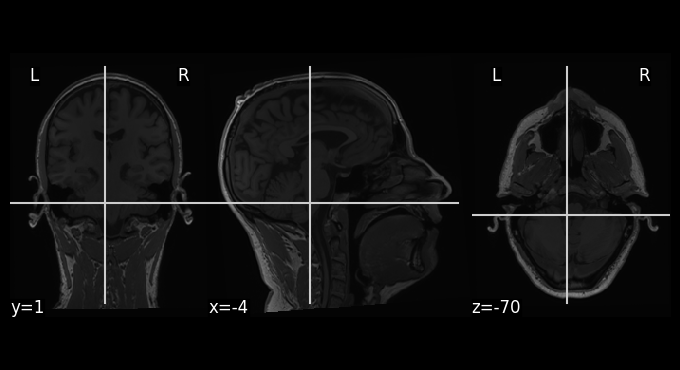

In [3]:
from nilearn import image, plotting
# If for some reason you don't have them - here are the URLs to the data.  
# https://github.com/celstark/n247data/raw/refs/heads/main/data/T1_al_segres.nii.gz
# https://github.com/celstark/n247data/raw/refs/heads/main/data/T1_al_seg.nii.gz

T1 = image.load_img('../data/T1_al_segres.nii.gz')
plotting.plot_anat(T1)

That's OK, but maybe a bit dark.  Maybe you want colors. Maybe you want a mosaic.  Go play.  Look at the [docs](https://nilearn.github.io/stable/modules/generated/nilearn.plotting.plot_anat.html#nilearn.plotting.plot_anat) and make a more fun display.

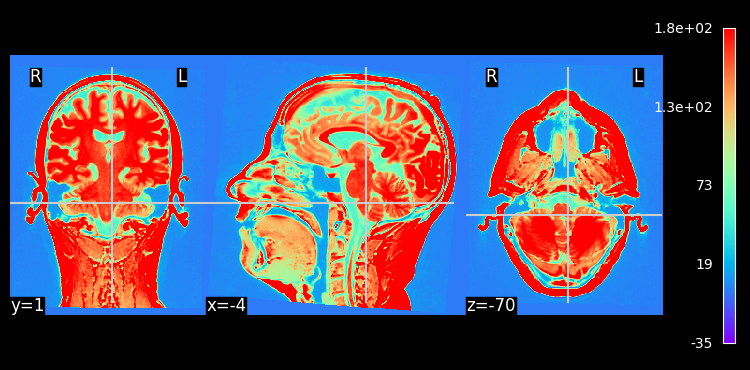

In [34]:
# plotting.plot_anat(T1, display_mode = "mosaic")

#vmin and vmax control darkness / brightness
plotting.plot_anat(T1, display_mode = "ortho", cmap="rainbow", colorbar = True, draw_cross=True, vmax=180, radiological=True, black_bg=True, annotate=True)

There's another nice routine in *nilearn* for plotting that's designed to let you plot images with overlays called [view_img](https://nilearn.github.io/stable/modules/generated/nilearn.plotting.view_img.html#nilearn.plotting.view_img). To use it, you build up a _display_, which can have a background image, an overlay, colormaps, etc.  By default, the background is an MNI T1. Here, I'll use the structural as both the overlay and as the background.


/Users/stark/miniforge3/envs/scipy/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



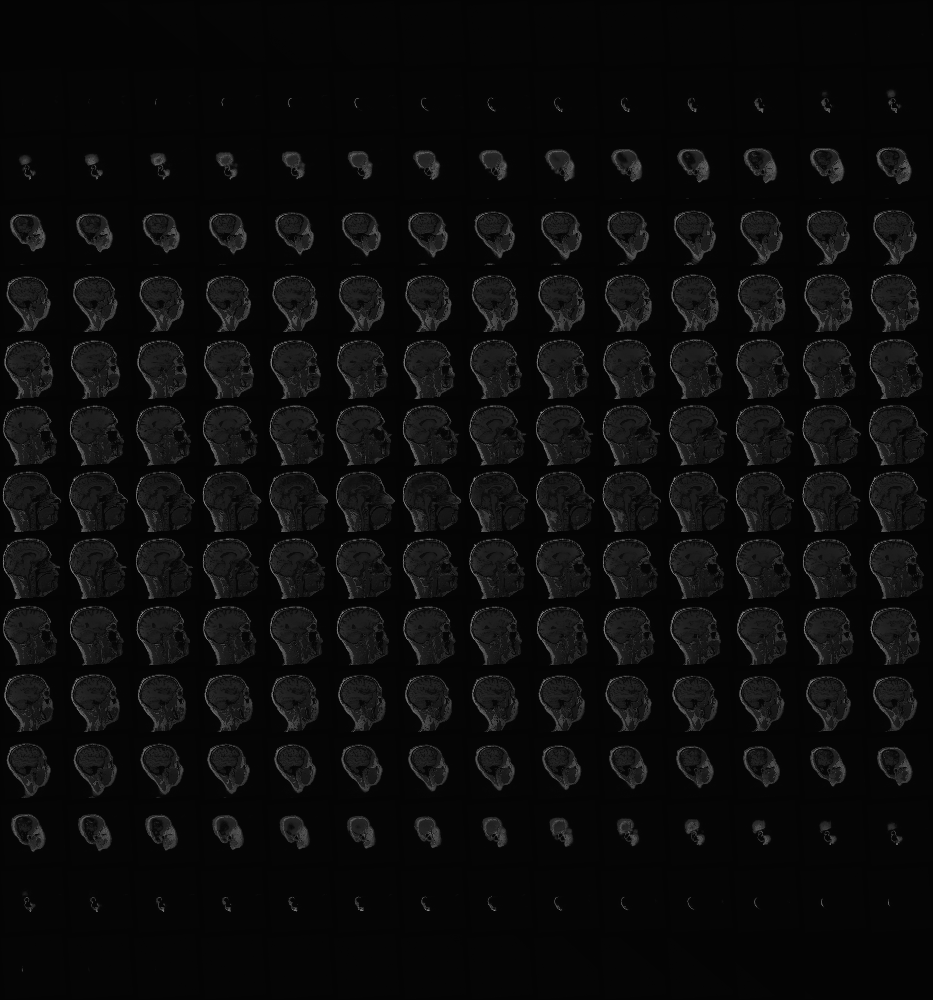
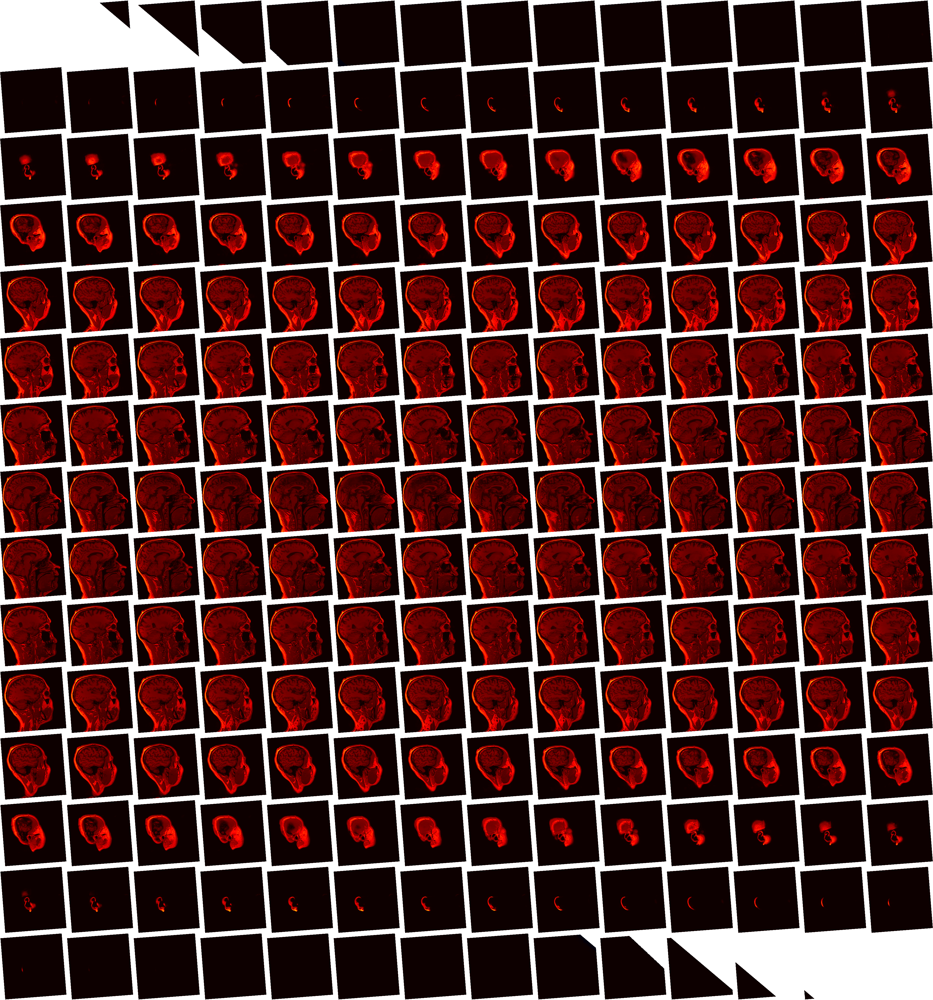

In [9]:
display=plotting.view_img(T1,bg_img=T1)
display

**Your turn**. Load up `T1_al_seg.nii.gz` and put it as an overlay on `T1_al_segres.nii.gz`

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/numpy/core/fromnumeric.py:771: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/nilearn/image/resampling.py:805: UserWarning: Casting data from int32 to float32
  return resample_img(



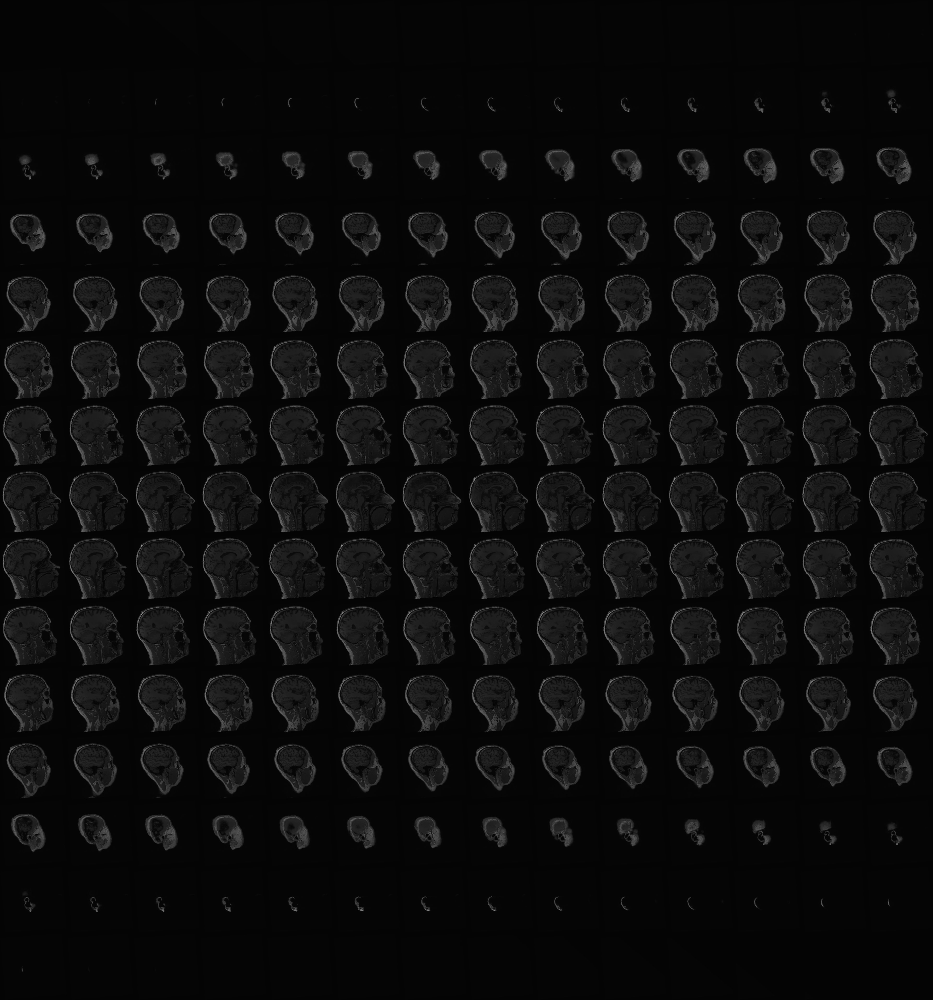
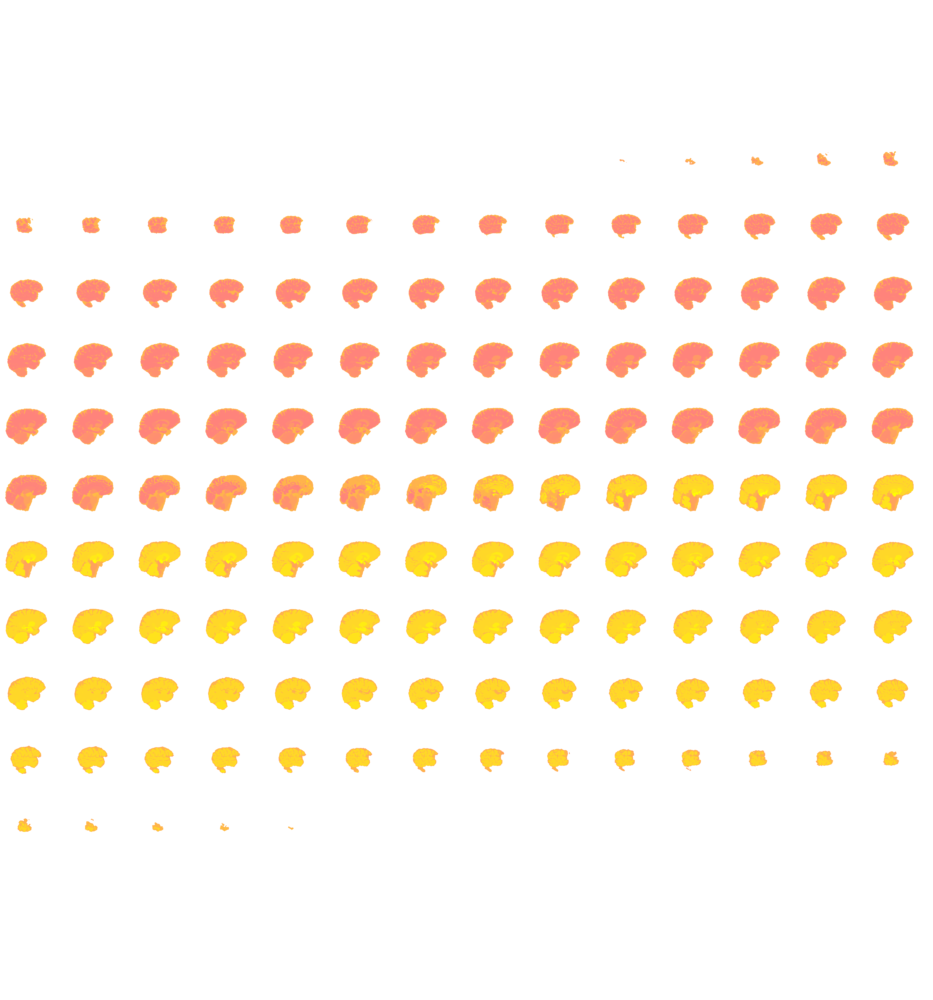

In [22]:
T1_al_seg = image.load_img('../data/T1_al_seg.nii.gz')
display2=plotting.view_img(T1_al_seg,bg_img=T1, cmap='spring')
display2

The segmentation labels have my hippocampi on 17 and 53.  How big are they?

When you load the images, they're returned as [Nibabel style nifti-images](https://nipy.org/nibabel/reference/nibabel.nifti1.html#nibabel.nifti1.Nifti1Image) which have a lot in them. You can access the actual data with `nilearn.image.get_data`. At this point, the images are just 3D Numpy arrays.

In [17]:
T1data = image.get_data(T1)
print(type(T1data),T1data.shape)

<class 'numpy.ndarray'> (205, 257, 257)
